##### Import Packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import plotly.express as px
from matplotlib.patches import ConnectionPatch
from matplotlib import cm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import dateutil.relativedelta
from datetime import datetime, timedelta

plt.style.use('fivethirtyeight')
pd.set_option('display.max_columns', None)

##### Preprocess Dataset

In [2]:
def convert_sic(sic):
    if sic in [i for i in range(1, 4)]:
        sic = "Agriculture"
    elif sic in [i for i in range(5, 10)]:
        sic = "Mining"
    elif sic in [i for i in range(10, 34)]:
        sic = "Manufacturing"
    elif sic == 35:
        sic = "Energy Supply"
    elif sic in [i for i in range(36, 40)]:
        sic = "Water and Waste"
    elif sic in [i for i in range(41, 44)]:
        sic = "Construction"
    elif sic == 45:
        sic = "Trade and Repair of Motor Vehicles"
    elif sic == 46:
        sic = "Wholesale Trade"
    elif sic == 47:
        sic = "Retail Trade"                
    elif sic in [i for i in range(49, 54)]:
        sic = "Transportation and Storage"
    elif sic in [i for i in range(55, 57)]:
        sic = "Accommodation and Food Service "
    elif sic in [i for i in range(58, 64)]:
        sic = "Information and Communication"
    elif sic in [i for i in range(64, 67)]:
        sic = "Financial and Insurance"
    elif sic == 68:
        sic = "Real Estate"
    elif sic in [i for i in range(69, 76)]:
        sic = "Professional, Scientific and Technical"
    elif sic in [i for i in range(77, 83)]:
        sic = "Administrative and Support Service"
    elif sic == 84:
        sic = "Public Service"
    elif sic == 85:
        sic = "Education"
    elif sic in [i for i in range(86, 89)]:
        sic = "Health and Social Work"
    elif sic in [i for i in range(90, 94)]:
        sic = "Arts and Entertainment"
    elif sic in [i for i in range(94, 97)]:
        sic = "Other Service"
    elif sic in [i for i in range(97, 99)]:
        sic = "Household Activities"
    elif sic == 99:
        sic = "Extraterritorial Bodies"
    else:
        sic = np.NAN
    return sic

def preprocess_dataset():

    # initialise start and end dates for filtering
    covid_date = datetime(2020, 3, 1)
    start_date = covid_date - dateutil.relativedelta.relativedelta(months=12)
    print(f"start_date: {start_date}")
    end_date = covid_date + dateutil.relativedelta.relativedelta(months=12)
    print(f"end_date: {end_date}")

    # read main dataset
    ori_df = pd.read_csv('BasicCompanyDataAsOneFile-2021-12-01.csv')
    filter_df = ori_df.copy()
    filter_df['IncorporationDate'] = pd.to_datetime(filter_df['IncorporationDate'], errors = 'coerce')
    filter_df = filter_df[(filter_df['IncorporationDate'] >= start_date) & (filter_df['IncorporationDate'] < end_date)]
    filter_df = filter_df.iloc[:, np.r_[0:2, 9:15, 26:30]]

    # drop unimportant rows
    clean_df = filter_df.copy()
    clean_df.columns = clean_df.columns.str.strip()
    clean_df = clean_df[clean_df["SICCode.SicText_1"] != "99999 - Dormant Company"]
    clean_df = clean_df[clean_df["SICCode.SicText_1"] != "None Supplied"]

    # create month and year columns
    clean_df["IncorporationMonth"]  = clean_df["IncorporationDate"].apply(lambda x:str(x.month))
    clean_df["IncorporationYear"]  = clean_df["IncorporationDate"].apply(lambda x:str(x.year))

    # extract first 2 digits from siccode
    clean_df.loc[:, "sic1"] = clean_df["SICCode.SicText_1"].str[0:2]
    clean_df.loc[:, "sic2"] = clean_df["SICCode.SicText_2"].str[0:2]
    clean_df.loc[:, "sic3"] = clean_df["SICCode.SicText_3"].str[0:2]
    clean_df.loc[:, "sic4"] = clean_df["SICCode.SicText_4"].str[0:2]

    # keep rows that have postcode
    clean_df.sort_values(by = "IncorporationDate",inplace = True)
    clean_df["industry_sic"] = clean_df["sic1"].apply(int).apply(convert_sic)
    clean_df = clean_df[~clean_df['RegAddress.PostCode'].isnull()]
    
    # merge location related data based on postcodes
    postcode_df = pd.read_csv('postcodes.csv')
    left = clean_df.copy()
    right = postcode_df[['Postcode','County','Country','Latitude', 'Longitude','London zone']]

    # final processing
    merge_df = pd.merge(left, right, how='left', left_on='RegAddress.PostCode', right_on='Postcode')
    merge_df = merge_df[~merge_df["Country"].isnull()]
    merge_df = merge_df[(merge_df['Latitude'] != 0) & (merge_df['Longitude'] != 0)]
    merge_df.drop(columns=["RegAddress.PostCode"], inplace=True)
    merge_df['Time Period'] = merge_df['IncorporationDate'].apply(lambda x: 'Pre-Covid' if x < datetime(2020, 3, 1) else 'Post-Covid')
    merge_df.to_csv('mattheus_smm635_fcp_data.csv', index=False)

# preprocess_dataset()

##### Read Pre-Processed Dataset (file within mattheus_smm635_fcp_data.zip)

In [3]:
# read pre-processed dataset
df = pd.read_csv('mattheus_smm635_fcp_data.csv')
df['IncorporationDate'] = pd.to_datetime(df['IncorporationDate'], errors = 'coerce')

### Introduction

A hypothesis driven approach was adopted to assess the effects of COVID-19 on businesses in the UK. Data was sourced from Companies House. Taking the month of the first COVID lockdown (March 2020) as point of reference, a subset of companies incorporated from March 2019 to Feb 2021 was selected as the period of interest.

The following 3 hypotheses were proposed and tested via insights gained from 3 charts to better understand the impact of COVID-19 in the UK:
1. More businesses were incorporated after lockdown because people tend to have more time to explore self-employment opportunities hence we would expect an upward trend after March 2020.
2. Top sectors would be retail and logistics related, whereas bottom sectors would be travel and accommodation because of lockdown restrictions. 
3. Newly incorporated companies from the top sectors are concentrated in central London.

### Graph 1

A monthly time series of companies incorporated in the UK was plotted to visualize the general trend and 2 coloured trend lines were fitted to distinguish pre-covid and post-covid trends. The chart also includes 2 pie-of-pie charts to compare the proportion of companies in the UK and London within a 12-month period before and after lockdown. Segments of interest were detached (exploded) to emphasize on the increase in proportions in London and Zone 1 after lockdown.

A clear upward trend is seen, hence proving our hypothesis that more businesses were incorporated after lockdown. Moreover, only London saw an increase in proportion which was derived from Zone 1 entirely.

#### Time Series and Pie-of-Pie Graph

<ipython-input-13-2855e8de5196>:119: UserWarning:

FixedFormatter should only be used together with FixedLocator



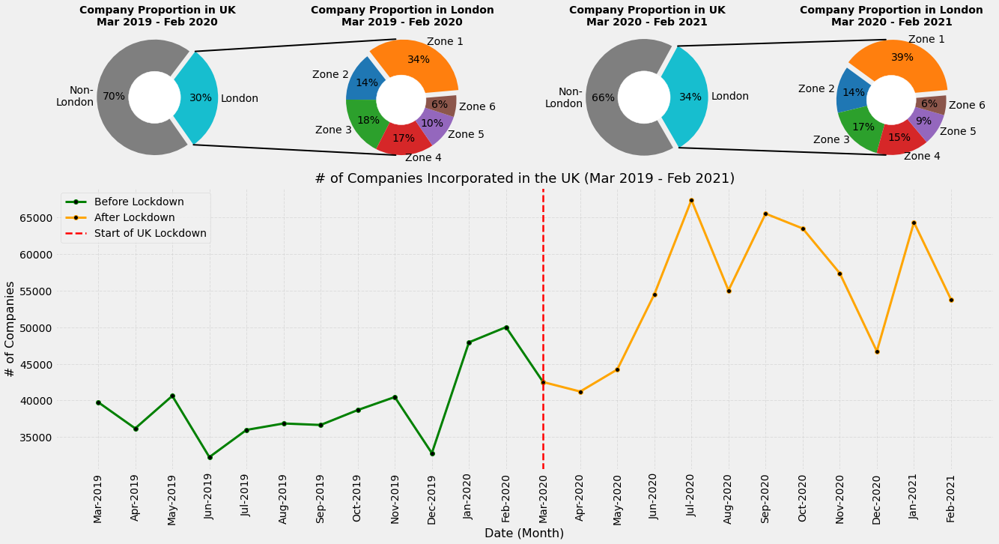

In [13]:
# splitting the trend data into pre-covid and post-covid
pivot_df = df.groupby(['IncorporationYear','IncorporationMonth'],as_index=False).size().rename(columns={"size": "# of Companies"})
pivot_df['Date (Month)'] = pivot_df.apply(lambda x: datetime(x['IncorporationYear'],x['IncorporationMonth'],1).strftime("%b")+'-'+str(x['IncorporationYear']), axis=1)
pivot_df['datetime'] = pivot_df.apply(lambda x: datetime(x['IncorporationYear'],x['IncorporationMonth'],1), axis=1)
line1 = pivot_df[pivot_df['datetime'] <= datetime(2020, 3, 1)]
line2 = pivot_df[pivot_df['datetime'] >= datetime(2020, 3, 1)]

# proportion of companies in UK segmented by London and Non-London
donut_df_1 = df.copy()
donut_df_1['group'] = np.where(donut_df_1['London zone'].isnull(), 'Non-London', 'London')
donut_df_1 = donut_df_1.groupby(['Time Period','group']).size().reset_index(name='count')
pre_sum = donut_df_1[donut_df_1['Time Period'] == 'Pre-Covid']['count'].sum()
post_sum = donut_df_1[donut_df_1['Time Period'] == 'Post-Covid']['count'].sum()
donut_df_1['% Companies'] = np.where(donut_df_1['Time Period'] == 'Pre-Covid', donut_df_1['count']/pre_sum, donut_df_1['count']/post_sum)

# proportion of companies from each zone in London
donut_df_2 = df.copy()
donut_df_2['group'] = np.where(donut_df_2['London zone'].isnull(), 'Non-London', 'London')
donut_df_2 = donut_df_2[donut_df_2['group'] == 'London']
donut_df_2['London zone'] = donut_df_2['London zone'].apply(int) 
donut_df_2 = donut_df_2.groupby(['Time Period','London zone']).size().reset_index(name='count')
pre_sum = donut_df_2[donut_df_2['Time Period'] == 'Pre-Covid']['count'].sum()
post_sum = donut_df_2[donut_df_2['Time Period'] == 'Post-Covid']['count'].sum()
donut_df_2['% Companies'] = np.where(donut_df_2['Time Period'] == 'Pre-Covid', donut_df_2['count']/pre_sum, donut_df_2['count']/post_sum)
donut_df_2 = donut_df_2[donut_df_2['London zone'] != 7]

def pie_chart(ax,sizes, labels, colors, startangle, fontsize, pctdistance, labeldistance=None, explode=None, normalize=True):
    ax.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.f%%', 
        startangle=startangle, textprops={'fontsize': fontsize}, 
        pctdistance=pctdistance, labeldistance=labeldistance, normalize=normalize)
    ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    circle=plt.Circle( (0,0), 0.45, color='white')
    ax.add_patch(circle)

def pie_chart_connection(ax1,ax2,width):
       #  Connection Lines betweein Pie 1 and Pie 2
       width = width
       theta1, theta2 = ax1.patches[0].theta1, ax1.patches[0].theta2
       center, r = ax1.patches[0].center, ax1.patches[0].r

       # draw top connecting line
       x = r * np.cos(np.pi / 180 * theta2) + center[0]
       y = np.sin(np.pi / 180 * theta2) + center[1]
       con = ConnectionPatch(xyA=(- width / 2, 1.1), xyB=(x, y),
                            coordsA="data", coordsB="data", axesA=ax2, axesB=ax1)
       con.set_color([0, 0, 0])
       con.set_linewidth(2)
       ax2.add_artist(con)

       # draw bottom connecting line
       x = r * np.cos(np.pi / 180 * theta1) + center[0]
       y = np.sin(np.pi / 180 * theta1) + center[1]
       con = ConnectionPatch(xyA=(- width / 2, -1), xyB=(x, y), coordsA="data",
                            coordsB="data", axesA=ax2, axesB=ax1)
       con.set_color([0, 0, 0])
       ax2.add_artist(con)
       con.set_linewidth(2)

# create subplots
fig = plt.figure(figsize=(20,10))
ax1 = plt.subplot2grid((3,4), (0, 0), colspan=1, rowspan=1)
ax2 = plt.subplot2grid((3,4), (0, 1), colspan=1, rowspan=1)
ax3 = plt.subplot2grid((3,4), (0, 2), colspan=1, rowspan=1) 
ax4 = plt.subplot2grid((3,4), (0, 3), colspan=1, rowspan=1)
ax5 = plt.subplot2grid((3,4), (1, 0), colspan=4, rowspan=2)

### settings
pie_val_dist = 0.7
pie_label_dist = 1.05
color1 = ['tab:cyan','tab:gray']
color2 = ['tab:orange','tab:blue','tab:green','tab:red','tab:purple','tab:brown']
pie_title_pad = 10

### Pie 1
test = donut_df_1[donut_df_1['Time Period'] == 'Pre-Covid']
labels = ['London','Non-\nLondon']
sizes = test['% Companies']
pie_chart(ax1, sizes, labels, color1, startangle=305, fontsize=14, pctdistance=pie_val_dist, 
          labeldistance=pie_label_dist, explode=[0.1, 0])
ax1.xaxis.set_label_position('top')
ax1.set_xlabel('Company Proportion in UK\nMar 2019 - Feb 2020', fontsize=14, 
                fontweight='bold', labelpad=pie_title_pad)

### Pie 2
test = donut_df_2[donut_df_2['Time Period'] == 'Pre-Covid']
labels = test['London zone'].apply(lambda x: 'Zone ' + str(x))
sizes = test['% Companies']
pie_chart(ax2, sizes, labels, color2, startangle=5, fontsize=14, pctdistance=pie_val_dist, 
          labeldistance=pie_label_dist, normalize=False, explode=[0.1,0,0,0,0,0])
pie_chart_connection(ax1,ax2,0.2)
ax2.xaxis.set_label_position('top')
ax2.set_xlabel('Company Proportion in London\nMar 2019 - Feb 2020', fontsize=14, 
                fontweight='bold', labelpad=pie_title_pad)

### Pie 3
test = donut_df_1[donut_df_1['Time Period'] == 'Post-Covid']
labels = ['London','Non-\nLondon']
sizes = test['% Companies']
pie_chart(ax3, sizes, labels, color1, startangle=300, fontsize=14, pctdistance=pie_val_dist, 
          labeldistance=pie_label_dist, explode=[0.1, 0])
ax3.xaxis.set_label_position('top')
ax3.set_xlabel('Company Proportion in UK\nMar 2020 - Feb 2021', fontsize=14, 
                fontweight='bold', labelpad=pie_title_pad)

### Pie 4
test = donut_df_2[donut_df_2['Time Period'] == 'Post-Covid']
labels = test['London zone'].apply(lambda x: 'Zone ' + str(x))
sizes = test['% Companies']
pie_chart(ax4, sizes, labels, color2, startangle=5, fontsize=14, pctdistance=pie_val_dist, 
          labeldistance=pie_label_dist, normalize=False, explode=[0.1,0,0,0,0,0])
pie_chart_connection(ax3,ax4,0.2)
ax4.xaxis.set_label_position('top')
ax4.set_xlabel('Company Proportion in London\nMar 2020 - Feb 2021', fontsize=14, 
                fontweight='bold', labelpad=pie_title_pad)

### Time series plot
ax5.plot(line1['Date (Month)'], line1['# of Companies'], color='green', linewidth=3, marker='o', markerfacecolor='k')
ax5.plot(line2['Date (Month)'], line2['# of Companies'], color='orange', linewidth=3, marker='o', markerfacecolor='k')
ax5.set_xticklabels(pivot_df['Date (Month)'], rotation=90, fontsize=14)
ax5.axvline('Mar-2020', 0, color='r', linestyle='--', linewidth=2.5)
ax5.legend(['Before Lockdown', 'After Lockdown','Start of UK Lockdown'], loc='upper left')
ax5.set_ylabel('# of Companies', fontsize=16)
ax5.set_xlabel('Date (Month)', fontsize=16)
ax5.set_title('# of Companies Incorporated in the UK (Mar 2019 - Feb 2021)', fontsize=18)
ax5.grid(linestyle='--', alpha=0.5)

plt.show()

### Graph 2

Diverging stacked bar chart was chosen to rank the top sectors in London according to difference in proportions before and after lockdown periods; contributions of Zone 1 and Other Zones towards the overall change were represented by stacked bars. This could be misleading when negative and positive values are present, hence a black line was fitted to highlight the precise overall change for each sector. Diverging bar chart was also included to illustrate the Top 10 sectors in London. Moreover, specific sectors were highlighted in red to emphasize that 4 industries in the Top 10 of Zone 1 were not in the Top 10 of London.

London:
- Retail trade saw an exponential growth compared to other sectors, which could be heavily contributed by e-commerce businesses.
- Transportation and storage being outside of the Top 10 in London could be due to travel restrictions from lockdown hence major transportation activities we centralized in Zone 1.

Zone 1:
- Information and communication ranking 4 in Zone 1 could mean more startups were incorporated.

#### Diverging Stacked Bar Graph with a nested Diverging Bar Graph

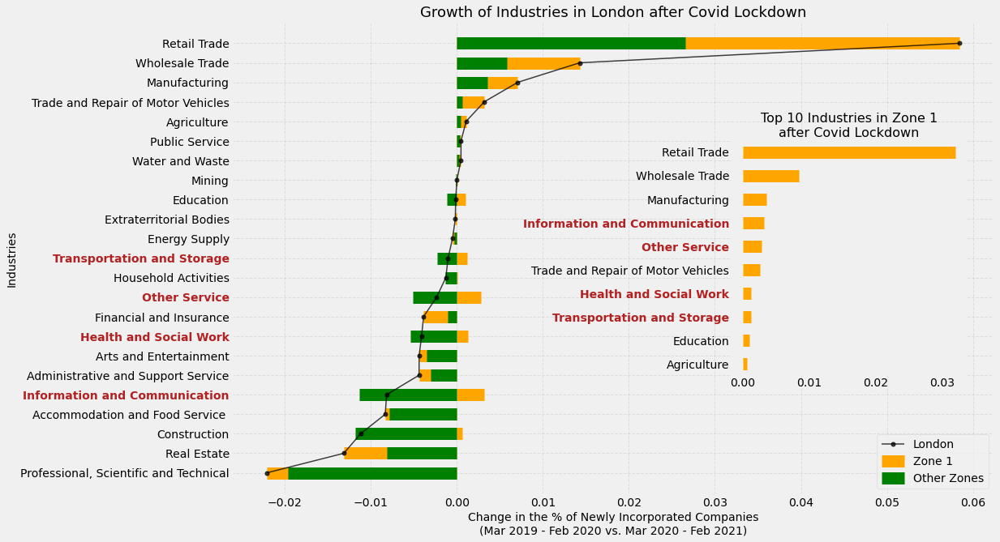

In [20]:
# growth in London only
pivot_df = df.copy()
pivot_df['group'] = np.where(pivot_df['London zone'].isnull(), 'Non-London', 'London')
pivot_df = pivot_df[pivot_df['group'] == 'London']
pivot_df = pivot_df.groupby(['Time Period','industry_sic']).size().reset_index(name='count')
pre_sum = pivot_df[pivot_df['Time Period'] == 'Pre-Covid']['count'].sum()
post_sum = pivot_df[pivot_df['Time Period'] == 'Post-Covid']['count'].sum()
pivot_df['% Companies'] = np.where(pivot_df['Time Period'] == 'Pre-Covid', pivot_df['count']/pre_sum, pivot_df['count']/post_sum)
pivot_df.sort_values(by=['Time Period','% Companies'], ascending=False, inplace=True)
left = pivot_df[pivot_df['Time Period'] == 'Pre-Covid']
right = pivot_df[pivot_df['Time Period'] == 'Post-Covid']
merge_df = pd.merge(left, right, on=['industry_sic'], how='left')
merge_df['% diff'] = merge_df['% Companies_y'] - merge_df['% Companies_x']
merge_df.sort_values(by=['% diff'], ascending=True, inplace=True)
merge_df.reset_index(drop=True, inplace=True)
london_growth_df = merge_df.copy()

# growth in Zone 1 and Other Zones
pivot_df = df.copy()
pivot_df['group'] = np.where(pivot_df['London zone'].isnull(), 'Non-London', 'London')
pivot_df = pivot_df[pivot_df['group'] == 'London']
pivot_df['London zone'] = pivot_df['London zone'].apply(int)
pivot_df['zone_group'] = np.where(pivot_df['London zone'] == 1, 'Zone 1', 'Other Zones')
pivot_df = pivot_df.groupby(['Time Period','zone_group','industry_sic']).size().reset_index(name='count')
pre_sum = pivot_df[pivot_df['Time Period'] == 'Pre-Covid']['count'].sum()
post_sum = pivot_df[pivot_df['Time Period'] == 'Post-Covid']['count'].sum()
pivot_df['% Companies'] = np.where(pivot_df['Time Period'] == 'Pre-Covid', pivot_df['count']/pre_sum, pivot_df['count']/post_sum)
pivot_df.sort_values(by=['Time Period','% Companies'], ascending=False, inplace=True)
left = pivot_df[pivot_df['Time Period'] == 'Pre-Covid']
right = pivot_df[pivot_df['Time Period'] == 'Post-Covid']
merge_df = pd.merge(left, right, on=['zone_group','industry_sic'], how='left')
merge_df['% diff'] = merge_df['% Companies_y'] - merge_df['% Companies_x']
merge_df.sort_values(by=['zone_group','% diff'], ascending=True, inplace=True)
merge_df.reset_index(drop=True, inplace=True)

# creating columns for plotting horizontal bars that are stacked
left = merge_df[merge_df['zone_group'] == 'Other Zones'][['zone_group','industry_sic','% diff']].reset_index(drop=True, inplace=False)
right = merge_df[merge_df['zone_group'] == 'Zone 1'][['zone_group','industry_sic','% diff']].reset_index(drop=True, inplace=False)
test_merge = pd.merge(left, right, on=['industry_sic'], how='left')
test_merge['other_min'] = test_merge.apply(lambda x: 0 if x['% diff_x'] > 0 else x['% diff_x'], axis=1)
test_merge['other_max'] = test_merge.apply(lambda x: 0 if x['% diff_x'] < 0 else x['% diff_x'], axis=1)
test_merge['zone1_min'] = test_merge.apply(lambda x: x['% diff_x'] + x['% diff_y'] if (x['% diff_x'] < 0 and x['% diff_y'] < 0) else 0, axis=1)
test_merge['zone1_max'] = test_merge.apply(lambda x: x['% diff_x'] + x['% diff_y'] if (x['% diff_x'] > 0 and x['% diff_y'] > 0) else 0 if (x['% diff_x'] < 0 and x['% diff_y'] < 0) else x['% diff_y'], axis=1)
test_merge = pd.merge(london_growth_df[['industry_sic']], test_merge, on=['industry_sic'], how='left')

# Top industries in Zone 1 only for nested  diverging bar chart
z1_df = merge_df[(merge_df['zone_group'] == 'Zone 1') & (merge_df['% diff'] > 0)].tail(10).reset_index(drop=True, inplace=False).sort_values(by=['% diff'], ascending=True)

# add subplot
plt.figure(figsize=(15, 10))
ax = plt.subplot(111)
ax.plot(list(london_growth_df['% diff']), test_merge.industry_sic, c='k', marker='o', alpha=0.75, linewidth=1.5, markersize=5)

# draw diverging stacked bar chart 
ax.hlines(y=test_merge.industry_sic, xmin=test_merge['zone1_min'], xmax=test_merge['zone1_max'], linewidth=15, color='orange')
ax.hlines(y=test_merge.industry_sic, xmin=test_merge['other_min'], xmax=test_merge['other_max'], linewidth=15, color='green')
ax.set_ylabel('Industries', fontsize=14)
ax.set_xlabel('Change in the % of Newly Incorporated Companies\n(Mar 2019 - Feb 2020 vs. Mar 2020 - Feb 2021)', fontsize=14)        
ax.set_title('Growth of Industries in London after Covid Lockdown', fontdict={'size': 18})
ax.legend(['London','Zone 1', 'Other Zones'], loc='lower right')
ax.grid(linestyle='--', alpha=0.5)

# highlighting specific industries in diverging stacked bar chart
for i in range(len(ax.yaxis.get_ticklabels())):
    if i == 4 or i == 7 or i == 9 or i == 11:
        ax.yaxis.get_ticklabels()[i].set_color('firebrick')
        ax.yaxis.get_ticklabels()[i].set_fontweight('bold')
    else:
        ax.yaxis.get_ticklabels()[i].set_color('k')

# draw nested diverging bar chart
axins = inset_axes(ax, width=4, height=4, loc=5, bbox_to_anchor=(0.97,0.5), bbox_transform=ax.transAxes)
axins.hlines(y=z1_df.industry_sic, xmin=0, xmax=z1_df['% diff'], linewidth=15, color='orange')
axins.set_title('Top 10 Industries in Zone 1\nafter Covid Lockdown', fontdict={'size': 16})
axins.grid(linestyle='--', alpha=0)

# highlighting specific industries in nested diverging bar chart
for i in range(len(axins.yaxis.get_ticklabels())):
    if i == 2 or i == 3 or i == 5 or i == 6:
        axins.yaxis.get_ticklabels()[i].set_color('firebrick')
        axins.yaxis.get_ticklabels()[i].set_fontweight('bold')
    else:
        axins.yaxis.get_ticklabels()[i].set_color('k')

plt.show()

### Graph 3

Geospatial graph chosen to visualize the distribution of companies in London from each sector. We know from graph 2 that Zone 1 had the largest growth in businesses but we can also visually identify the specific areas in Zone 1. For each industry, we can see companies concentrated around Mayfair, Soho, Covent Garden and Farringdon.

#### Interactive Geospatial Graph

In [21]:
# get industries ranked in London
ranked_sic_london = london_growth_df.sort_values(by=['% diff'], ascending=False)[['industry_sic']].reset_index(drop=True)
ranked_sic_london['rank'] = ranked_sic_london.index + 1

# get London companies data post-covid
graph3_df = df.copy()
graph3_df['group'] = np.where(graph3_df['London zone'].isnull(), 'Non-London', 'London')
graph3_df = graph3_df[graph3_df['group'] == 'London']
graph3_df = graph3_df[graph3_df['Time Period'] == 'Post-Covid']
graph3_df = pd.merge(graph3_df, ranked_sic_london, on=['industry_sic'], how='left')
graph3_df.rename(columns={'industry_sic':'Industries (Ranked in London)', 'London zone': 'London Zone'}, inplace=True)
graph3_df.sort_values(by=['rank'], ascending=True, inplace=True)

# plot interactive geospatial graph 
fig = px.scatter_mapbox(graph3_df, lat='Latitude', lon='Longitude', color='Industries (Ranked in London)', opacity = 0.25,
                        hover_name='CompanyName', hover_data=['London Zone','County'], center=dict(lat=51.506462, lon=-0.1361799), 
                        zoom=10, mapbox_style="stamen-toner", width=1000, height=600).update_layout(margin=dict(l=20, r=20, t=20, b=20)).show()